In [7]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
!export PYTHONNOUSERSITE=1

In [3]:
import sys
sys.path
# get rid of user site
sys.path.remove( '/n/home12/binxuwang/.local/lib/python3.10/site-packages')

In [8]:
import torch
import matplotlib.pyplot as plt
import sys
sys.path.append("/n/home12/binxuwang/Github/DiffusionLearningCurve")
from core.diffusion_nn_lib import UNetBlockStyleMLP_backbone
from core.gaussian_mixture_lib import GaussianMixture_torch
from core.toy_shape_dataset_lib import generate_random_star_shape_torch
from core.diffusion_edm_lib import EDMPrecondWrapper, EDMLoss, train_score_model_custom_loss, edm_sampler
def get_device():
    if torch.cuda.is_available():
        device = torch.device("cuda")
    elif torch.backends.mps.is_available():
        device = torch.device("mps")
    else:
        device = torch.device("cpu")
    return device


### Gaussian mixture demo

In [9]:
from core.gaussian_mixture_lib import GaussianMixture_torch

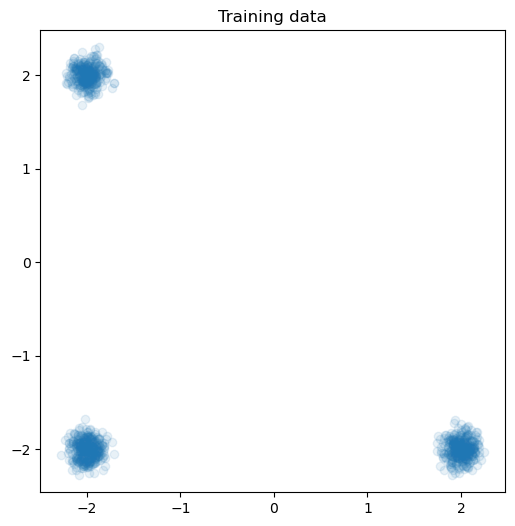

In [49]:
ndim = 50
sigma_g = 0.1
id_cov = torch.eye(ndim)
mus_onmanif = [[-2, -2], [2, -2], [-2, 2]]
mus_all = [torch.tensor(mus_onmanif[i] + [0.0] * (ndim - 2)) for i in range(len(mus_onmanif))]
gm = GaussianMixture_torch(mus=mus_all, 
                          covs=[sigma_g**2 * id_cov, sigma_g**2 * id_cov, sigma_g**2 * id_cov, ], 
                          weights=[1.0, 1.0, 1.0])
pnts, _, _ = gm.sample(1000)
plt.figure(figsize=[6, 6])
plt.scatter(pnts[:,0], pnts[:,1], alpha=0.1)
plt.axis("equal")
plt.title("Training data")
plt.show()

In [20]:
pnts, _, _ = gm.sample(1000)
pnts = pnts.float()
device = get_device()
model = UNetBlockStyleMLP_backbone(ndim=ndim, nlayers=5, nhidden=64, time_embed_dim=64,)
model_precd = EDMPrecondWrapper(model, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)
edm_loss_fn = EDMLoss(P_mean=-1.2, P_std=1.2, sigma_data=0.5)
model_precd, loss_traj = train_score_model_custom_loss(pnts, model_precd, edm_loss_fn, 
                                    lr=0.001, nepochs=2000, batch_size=1024, device=device,
                                    callback=None, callback_freq=100)

noise_init = torch.randn(1000, ndim).to(device)
x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model_precd, noise_init, 
                num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)

  0%|          | 0/2000 [00:00<?, ?it/s]

step 0 loss 2.162


In [15]:
model

UNetBlockStyleMLP_backbone(
  (embed): GaussianFourierProjection()
  (net): ModuleList(
    (0): UNetMLPBlock(
      (norm0): LayerNorm((10,), eps=1e-05, elementwise_affine=True)
      (fc0): Linear(in_features=10, out_features=64, bias=True)
      (affine): Linear(in_features=64, out_features=128, bias=True)
      (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
      (fc1): Linear(in_features=64, out_features=64, bias=True)
      (skip): Linear(in_features=10, out_features=64, bias=True)
    )
    (1): Linear(in_features=64, out_features=10, bias=True)
  )
)

  0%|          | 0/2000 [00:00<?, ?it/s]

step 0 loss 1.049


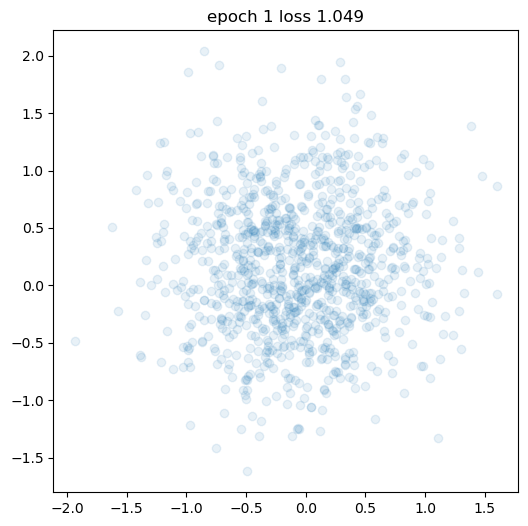

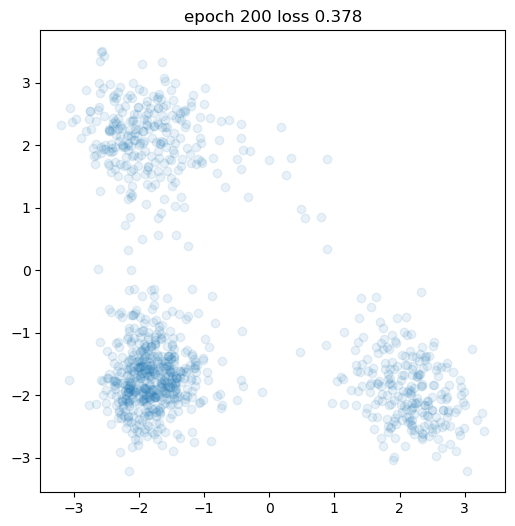

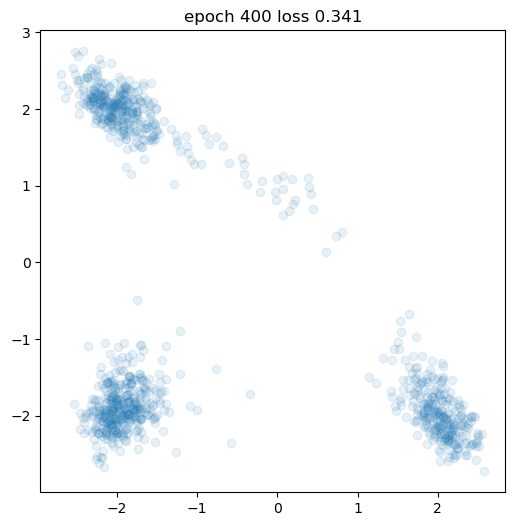

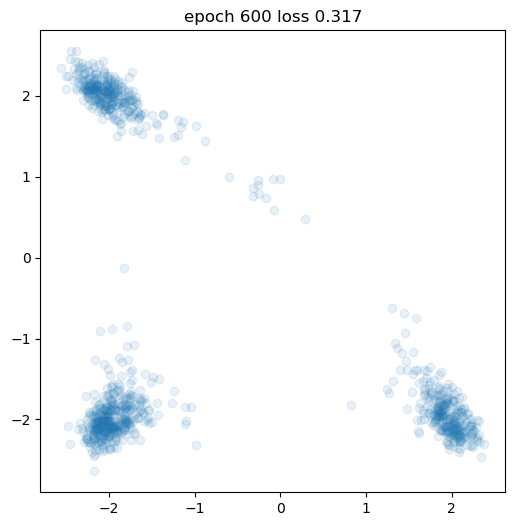

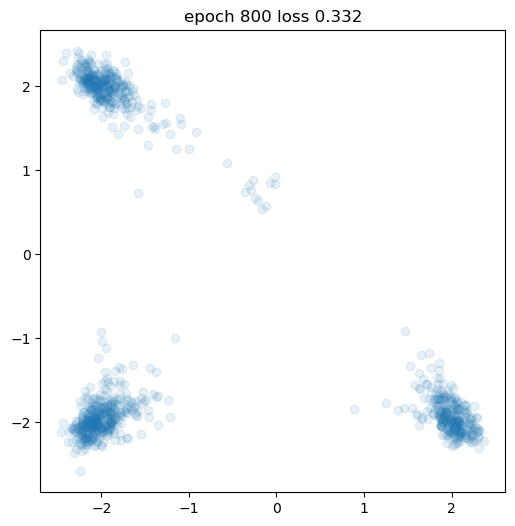

...

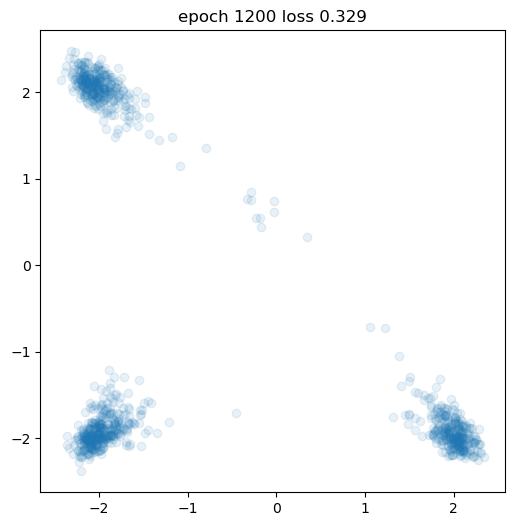

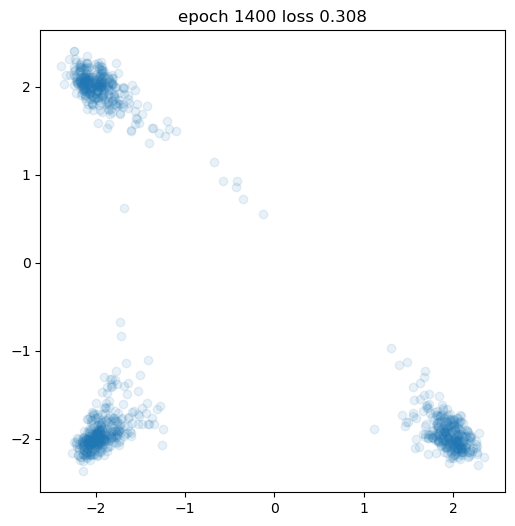

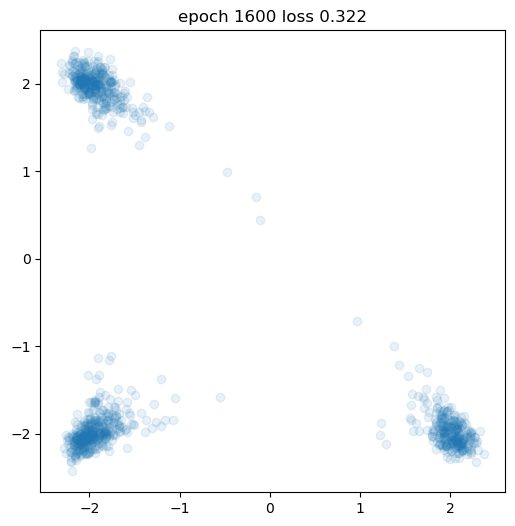

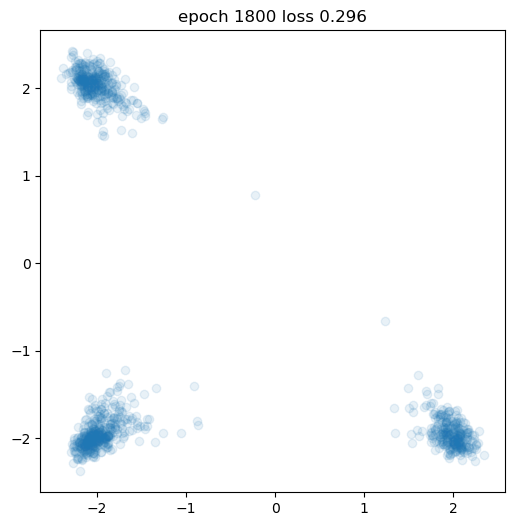

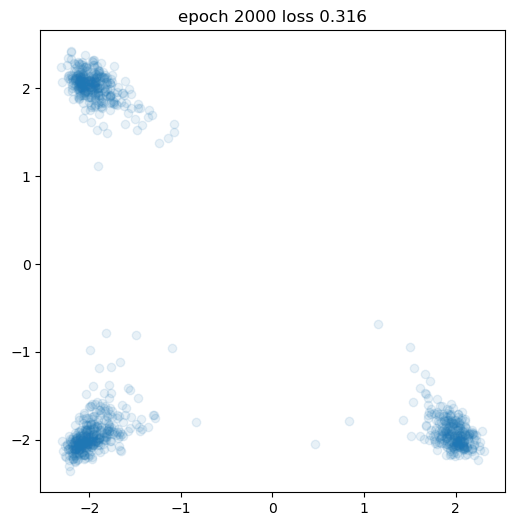

In [26]:
pnts, _, _ = gm.sample(1000)
pnts = pnts.float()
device = get_device()
model = UNetBlockStyleMLP_backbone(ndim=ndim, nlayers=1, nhidden=64, time_embed_dim=64,)
model_precd = EDMPrecondWrapper(model, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)
edm_loss_fn = EDMLoss(P_mean=-1.2, P_std=1.2, sigma_data=0.5)

loss_collection = {}
sample_out_collection = {}
def sample_and_plot_callback(epoch, loss, model):
    noise_init = torch.randn(1000, ndim, generator=torch.Generator(device=device), device=device)#.to(device)
    x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model, noise_init, 
            num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)
    x_out_np = x_out.cpu().numpy()
    loss_collection[epoch] = loss
    sample_out_collection[epoch] = x_out_np
    plt.figure(figsize=[6, 6])
    plt.scatter(x_out_np[:, 0], x_out_np[:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    plt.title(f"epoch {epoch} loss {loss:.3f}")
    plt.show()

model_precd, loss_traj = train_score_model_custom_loss(pnts, model_precd, edm_loss_fn, 
                                    lr=0.001, nepochs=2000, batch_size=1024, device=device,
                                    callback=sample_and_plot_callback, callback_freq=200)

noise_init = torch.randn(1000, ndim).to(device)
x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model_precd, noise_init, 
                num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)

  0%|          | 0/200 [00:00<?, ?it/s]

step 0 loss 1.042


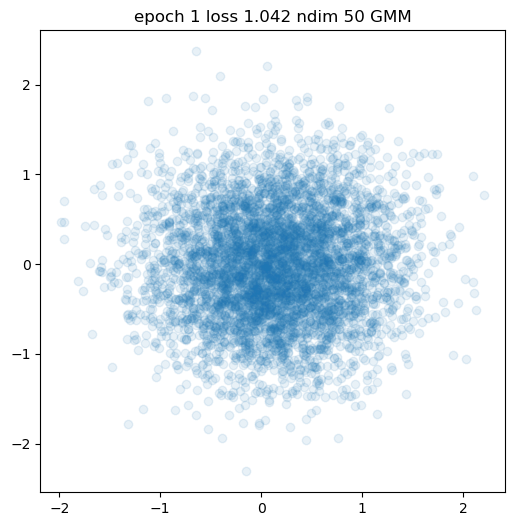

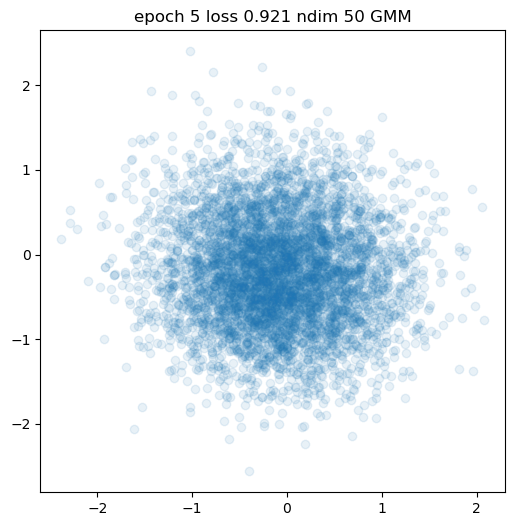

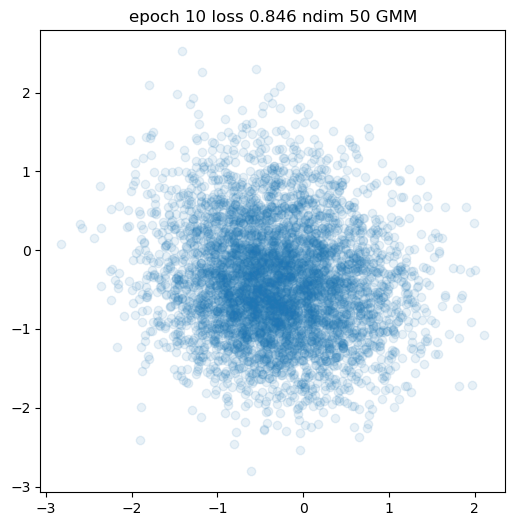

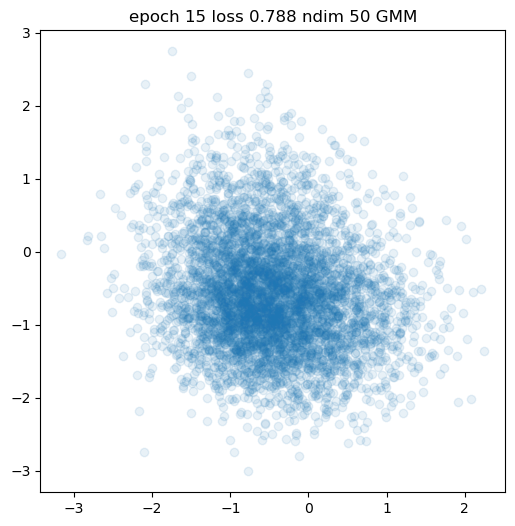

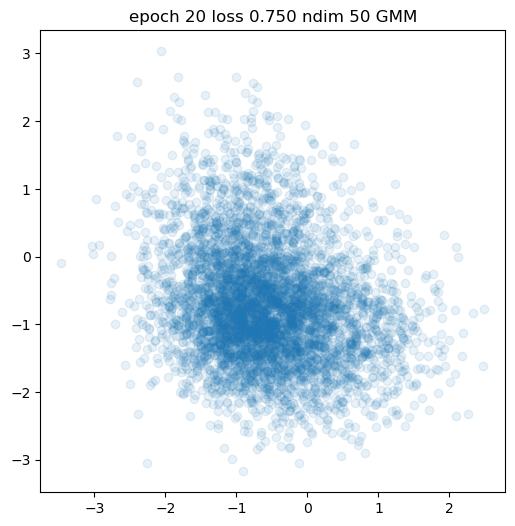

...

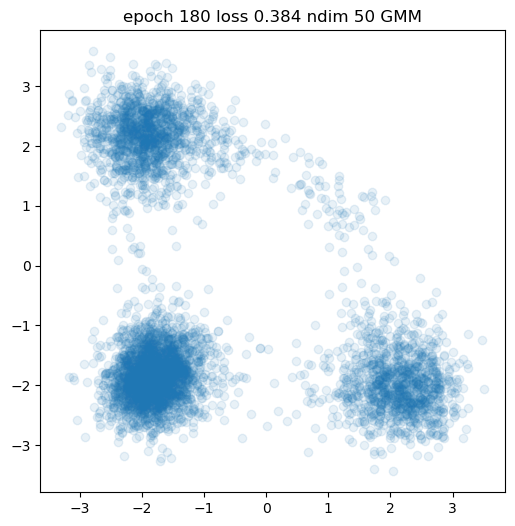

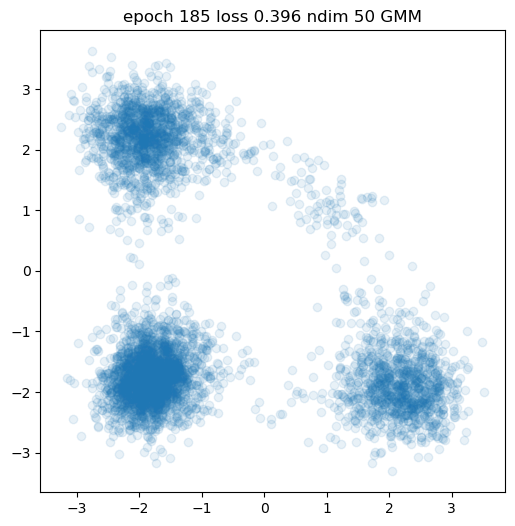

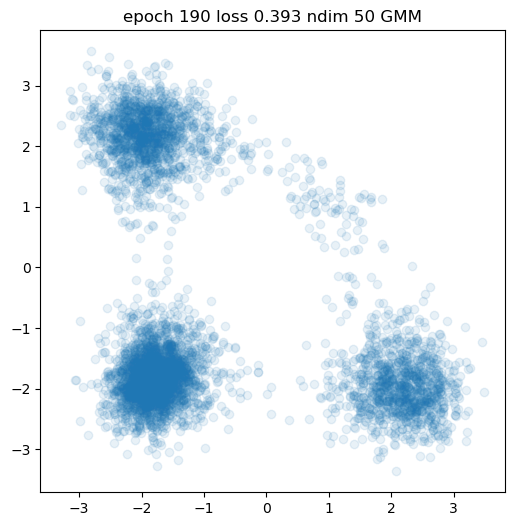

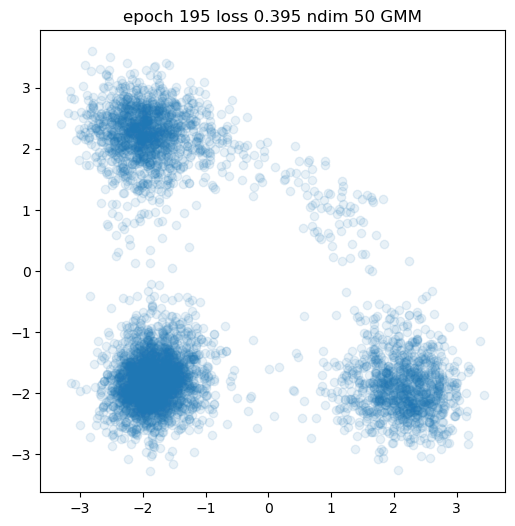

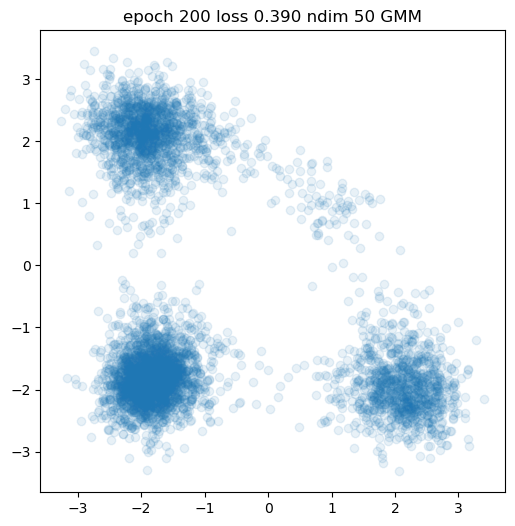

In [28]:
pnts, _, _ = gm.sample(1000)
pnts = pnts.float()
device = get_device()
model = UNetBlockStyleMLP_backbone(ndim=ndim, nlayers=1, nhidden=64, time_embed_dim=64,)
model_precd = EDMPrecondWrapper(model, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)
edm_loss_fn = EDMLoss(P_mean=-1.2, P_std=1.2, sigma_data=0.5)

loss_collection = {}
sample_out_collection = {}
def sample_and_plot_callback(epoch, loss, model):
    noise_init = torch.randn(5000, ndim, generator=torch.Generator(device=device), device=device)#.to(device)
    x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model, noise_init, 
            num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)
    x_out_np = x_out.cpu().numpy()
    loss_collection[epoch] = loss
    sample_out_collection[epoch] = x_out_np
    plt.figure(figsize=[6, 6])
    plt.scatter(x_out_np[:, 0], x_out_np[:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    plt.title(f"epoch {epoch} loss {loss:.3f} ndim {ndim} GMM")
    plt.show()

model_precd, loss_traj = train_score_model_custom_loss(pnts, model_precd, edm_loss_fn, 
                                    lr=0.001, nepochs=200, batch_size=1024, device=device,
                                    callback=sample_and_plot_callback, callback_freq=5)

noise_init = torch.randn(1000, ndim).to(device)
x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model_precd, noise_init, 
                num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)

In [37]:
model

UNetBlockStyleMLP_backbone(
  (embed): GaussianFourierProjection()
  (net): ModuleList(
    (0): UNetMLPBlock(
      (norm0): LayerNorm((50,), eps=1e-05, elementwise_affine=True)
      (fc0): Linear(in_features=50, out_features=64, bias=True)
      (affine): Linear(in_features=64, out_features=128, bias=True)
      (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
      (fc1): Linear(in_features=64, out_features=64, bias=True)
      (skip): Linear(in_features=50, out_features=64, bias=True)
    )
    (1): Linear(in_features=64, out_features=50, bias=True)
  )
)

### Record initial learning dynamics

In [55]:
pnts, _, _ = gm.sample(1000)
pnts = pnts.float()
device = get_device()
model = UNetBlockStyleMLP_backbone(ndim=ndim, nlayers=1, nhidden=64, time_embed_dim=64,)
model_precd = EDMPrecondWrapper(model, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)
edm_loss_fn = EDMLoss(P_mean=-1.2, P_std=1.2, sigma_data=0.5)

loss_collection = {}
sample_out_collection = {}
def sample_and_collect_callback(epoch, loss, model):
    noise_init = torch.randn(5000, ndim, generator=torch.Generator(device=device), device=device)#.to(device)
    x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model, noise_init, 
            num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)
    x_out_np = x_out.cpu().numpy()
    loss_collection[epoch] = loss
    sample_out_collection[epoch] = x_out_np
    # plt.figure(figsize=[6, 6])
    # plt.scatter(x_out_np[:, 0], x_out_np[:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    # plt.title(f"epoch {epoch} loss {loss:.3f} ndim {ndim} GMM")
    # plt.show()

model_precd, loss_traj = train_score_model_custom_loss(pnts, model_precd, edm_loss_fn, 
                                    lr=0.001, nepochs=1000, batch_size=1024, device=device, 
                                    callback=sample_and_collect_callback, callback_freq=2)

noise_init = torch.randn(1000, ndim).to(device)
x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model_precd, noise_init, 
                num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)

  0%|          | 0/1000 [00:00<?, ?it/s]

step 0 loss 1.043


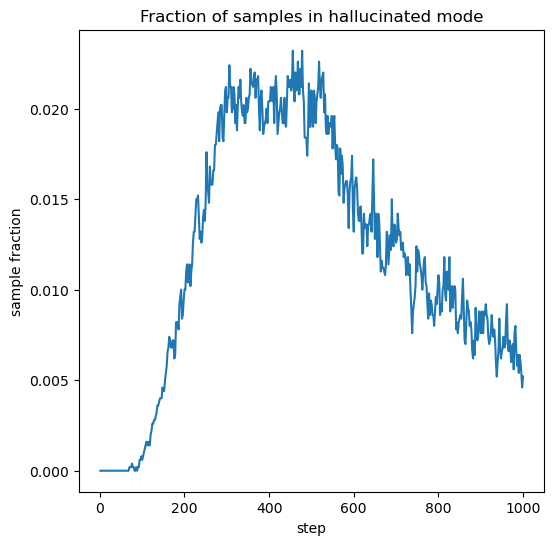

In [57]:
hall_mode_count_collection = {}
for epoch in sample_out_collection:
    in_hall_mode_mask = (sample_out_collection[epoch][:, 0] > 0.) & (sample_out_collection[epoch][:, 1] > 0.)
    # and all the other axes are in this range
    for i in range(2, ndim):
        in_hall_mode_mask &= (sample_out_collection[epoch][:, i] > -0.5) & (sample_out_collection[epoch][:, i] < 0.5)
    hall_mode_count = in_hall_mode_mask.sum()
    hall_mode_count_collection[epoch] = hall_mode_count / len(sample_out_collection[epoch])
    # print(f"epoch {epoch} in hall mode {in_hall_mode_mask.mean():.3f}")

plt.figure(figsize=[6, 6])
plt.plot(hall_mode_count_collection.keys(), hall_mode_count_collection.values())
plt.ylabel("sample fraction")
plt.xlabel("step")
plt.title("Fraction of samples in hallucinated mode")
plt.savefig("hallucinated_mode_fraction.png")
plt.show()

In [40]:
import matplotlib.pyplot as plt
from PIL import Image
import io
from IPython.display import Video
import numpy as np
import moviepy.editor as mpy

In [60]:
frames = []
for epoch in sample_out_collection:
    fig, ax = plt.subplots(figsize=[6, 6])
    plt.scatter(sample_out_collection[epoch][:, 0], sample_out_collection[epoch][:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    plt.title(f"epoch {epoch} loss {loss_collection[epoch]:.3f} {ndim}dim GMM")
    # fig, ax = plt.subplots()
    # ax.plot([j for j in range(i, i + 10)], [j**2 for j in range(i, i + 10)])
    # ax.set_title(f'Plot {i}')
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    plt.close(fig)
    buf.seek(0)
    # Convert buffer to PIL Image
    img = Image.open(buf).convert('RGB')  # Convert to RGB to ensure compatibility
    frames.append(np.array(img))  # Convert PIL Image to numpy array

In [59]:
len(frames)

251

In [61]:
fps = 5  # Adjust as needed
# Create an ImageSequenceClip
clip = mpy.ImageSequenceClip(frames, fps=fps)
# Save the video file
video_filename = 'animated_p_gen_dynamics_1000.mp4'  # Change to 'animated_plots.mov' for MOV format
clip.write_videofile(video_filename, codec='libx264')

Moviepy - Building video animated_p_gen_dynamics_1000.mp4.
Moviepy - Writing video animated_p_gen_dynamics_1000.mp4



Moviepy - Done !
Moviepy - video ready animated_p_gen_dynamics_1000.mp4


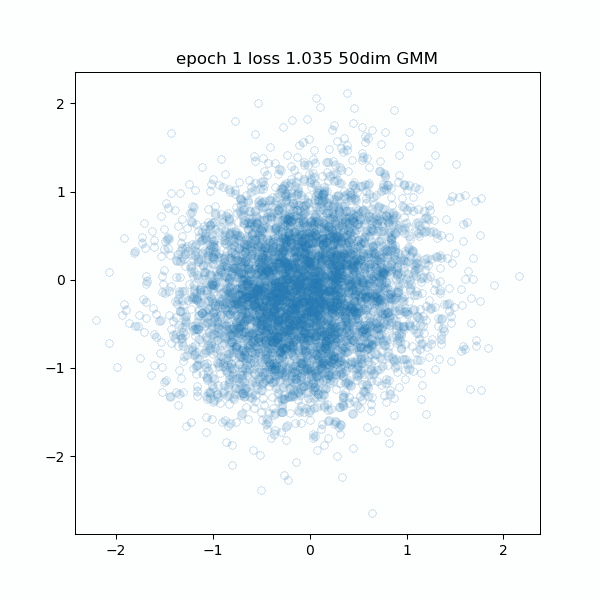

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import io
from IPython.display import Image as IPythonImage

images = []
for epoch in sample_out_collection:
    fig, ax = plt.subplots(figsize=[6, 6])
    plt.scatter(sample_out_collection[epoch][:, 0], sample_out_collection[epoch][:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    plt.title(f"epoch {epoch} loss {loss_collection[epoch]:.3f} {ndim}dim GMM")
    # fig, ax = plt.subplots()
    # ax.plot([j for j in range(i, i + 10)], [j**2 for j in range(i, i + 10)])
    # ax.set_title(f'Plot {i}')
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    plt.close(fig)
    buf.seek(0)
    images.append(Image.open(buf))

gif_filename = 'animated_p_gen_dynamics.gif'
images[0].save(
    gif_filename,
    save_all=True,
    append_images=images[1:],
    duration=500,
    loop=0
)

IPythonImage(filename=gif_filename)

### Long term learning dynamics

In [62]:
pnts, _, _ = gm.sample(1000)
pnts = pnts.float()
device = get_device()
model = UNetBlockStyleMLP_backbone(ndim=ndim, nlayers=1, nhidden=64, time_embed_dim=64,)
model_precd = EDMPrecondWrapper(model, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)
edm_loss_fn = EDMLoss(P_mean=-1.2, P_std=1.2, sigma_data=0.5)

loss_collection = {}
sample_out_collection = {}
def sample_and_collect_callback(epoch, loss, model):
    noise_init = torch.randn(5000, ndim, generator=torch.Generator(device=device), device=device)#.to(device)
    x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model, noise_init, 
            num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)
    x_out_np = x_out.cpu().numpy()
    loss_collection[epoch] = loss
    sample_out_collection[epoch] = x_out_np
    # plt.figure(figsize=[6, 6])
    # plt.scatter(x_out_np[:, 0], x_out_np[:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    # plt.title(f"epoch {epoch} loss {loss:.3f} ndim {ndim} GMM")
    # plt.show()

model_precd, loss_traj = train_score_model_custom_loss(pnts, model_precd, edm_loss_fn, 
                                    lr=0.001, nepochs=5000, batch_size=1024, device=device, 
                                    callback=sample_and_collect_callback, callback_freq=25)

noise_init = torch.randn(1000, ndim).to(device)
x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model_precd, noise_init, 
                num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)

  0%|          | 0/5000 [00:00<?, ?it/s]

step 0 loss 1.033


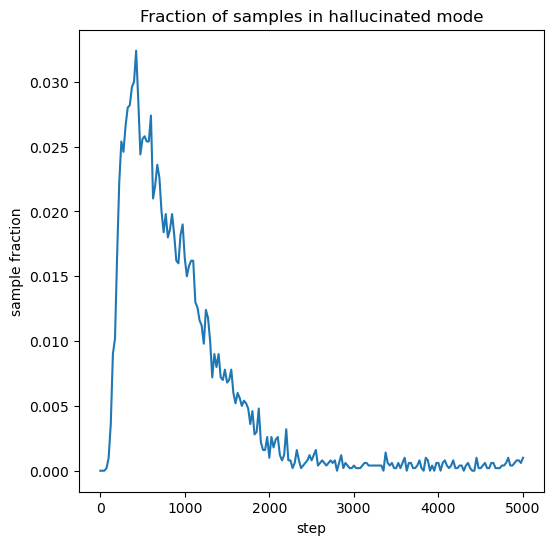

In [63]:
hall_mode_count_collection = {}
for epoch in sample_out_collection:
    in_hall_mode_mask = (sample_out_collection[epoch][:, 0] > 0.) & (sample_out_collection[epoch][:, 1] > 0.)
    # and all the other axes are in this range
    for i in range(2, ndim):
        in_hall_mode_mask &= (sample_out_collection[epoch][:, i] > -0.5) & (sample_out_collection[epoch][:, i] < 0.5)
    hall_mode_count = in_hall_mode_mask.sum()
    hall_mode_count_collection[epoch] = hall_mode_count / len(sample_out_collection[epoch])
    # print(f"epoch {epoch} in hall mode {in_hall_mode_mask.mean():.3f}")

plt.figure(figsize=[6, 6])
plt.plot(hall_mode_count_collection.keys(), hall_mode_count_collection.values())
plt.ylabel("sample fraction")
plt.xlabel("step")
plt.title("Fraction of samples in hallucinated mode")
plt.savefig("hallucinated_mode_fraction_5000.png")
plt.show()

In [64]:
import matplotlib.pyplot as plt
from PIL import Image
import io
from IPython.display import Video
import numpy as np
import moviepy.editor as mpy

In [68]:
len(frames2)

85

In [69]:
plt.close("all")

In [70]:
frames2 = []
for epoch in sample_out_collection:
    fig, ax = plt.subplots(figsize=[6, 6])
    plt.scatter(sample_out_collection[epoch][:, 0], sample_out_collection[epoch][:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    plt.title(f"epoch {epoch} loss {loss_collection[epoch]:.3f} {ndim}dim GMM")
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    plt.close(fig)
    buf.seek(0)
    # Convert buffer to PIL Image
    img = Image.open(buf).convert('RGB')  # Convert to RGB to ensure compatibility
    frames2.append(np.array(img))  # Convert PIL Image to numpy array

In [71]:
fps = 5  # Adjust as needed
# Create an ImageSequenceClip
clip = mpy.ImageSequenceClip(frames2, fps=fps)
# Save the video file
video_filename = 'animated_p_gen_dynamics_5000.mp4'  # Change to 'animated_plots.mov' for MOV format
clip.write_videofile(video_filename, codec='libx264')

Moviepy - Building video animated_p_gen_dynamics_5000.mp4.
Moviepy - Writing video animated_p_gen_dynamics_5000.mp4



Moviepy - Done !
Moviepy - video ready animated_p_gen_dynamics_5000.mp4


In [ ]:
for epoch in sample_out_collection:
    plt.figure(figsize=[6, 6])
    plt.scatter(sample_out_collection[epoch][:, 0], sample_out_collection[epoch][:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
    plt.title(f"epoch {epoch} loss {loss_collection[epoch]:.3f} {ndim}dim GMM")
    plt.show()


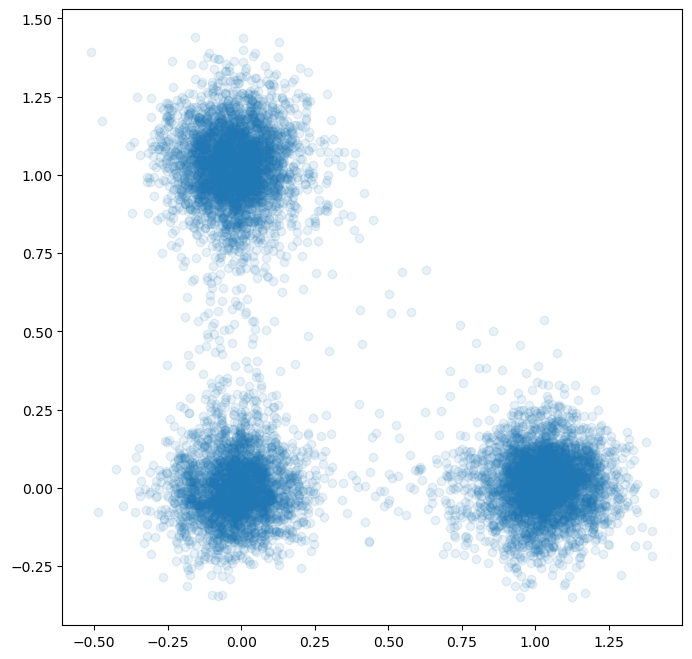

In [32]:
noise_init = torch.randn(10000, ndim).to(device)
x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model_precd, noise_init, 
                num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)
x_out_np = x_out.cpu().numpy()
plt.figure(figsize=[8, 8])
plt.scatter(x_out_np[:,0], x_out_np[:,1], alpha=0.1) # , c=t_steps_np cmap="viridis"
plt.show()

### Star shape demo

In [5]:
pnts, radius_fun, amplitudes, phases = generate_random_star_shape_torch(1000, num_modes=10)
pnts = pnts.float()
device = get_device()
model = UNetBlockStyleMLP_backbone(ndim=2, nlayers=5, nhidden=64, time_embed_dim=64,)
model_precd = EDMPrecondWrapper(model, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)
edm_loss_fn = EDMLoss(P_mean=-1.2, P_std=1.2, sigma_data=0.5)
model_precd, loss_traj = train_score_model_custom_loss(pnts, model_precd, edm_loss_fn, 
                                    lr=0.001, nepochs=2000, batch_size=1024, device=device)

noise_init = torch.randn(1000, 2).to(device)
x_out, x_traj, x0hat_traj, t_steps = edm_sampler(model_precd, noise_init, 
                num_steps=20, sigma_min=0.002, sigma_max=80, rho=7, return_traj=True)

  0%|          | 0/2000 [00:00<?, ?it/s]

step 0 loss 1.397


In [11]:
x_traj_np.shape

(21, 1000, 2)

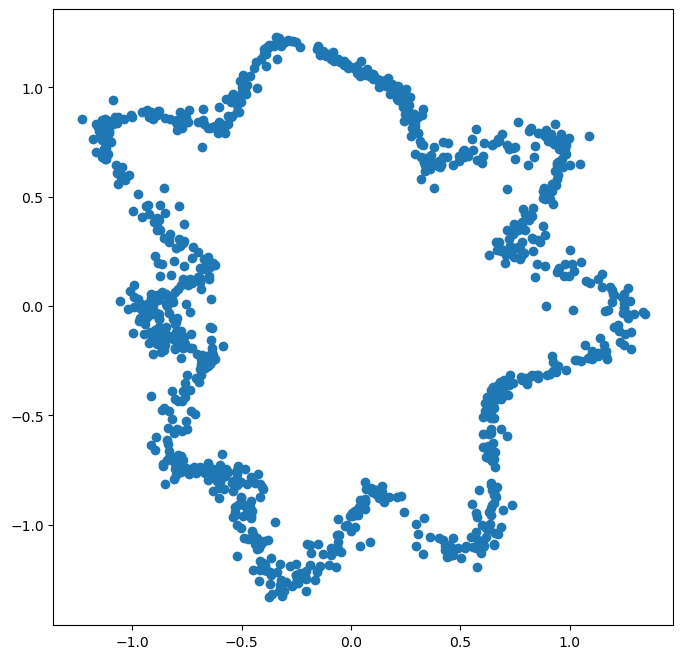

In [19]:
x_out = x_out
plt.figure(figsize=[8, 8])
plt.scatter(x_out[:,0], x_out[:,1], ) # , c=t_steps_np cmap="viridis"
plt.show()

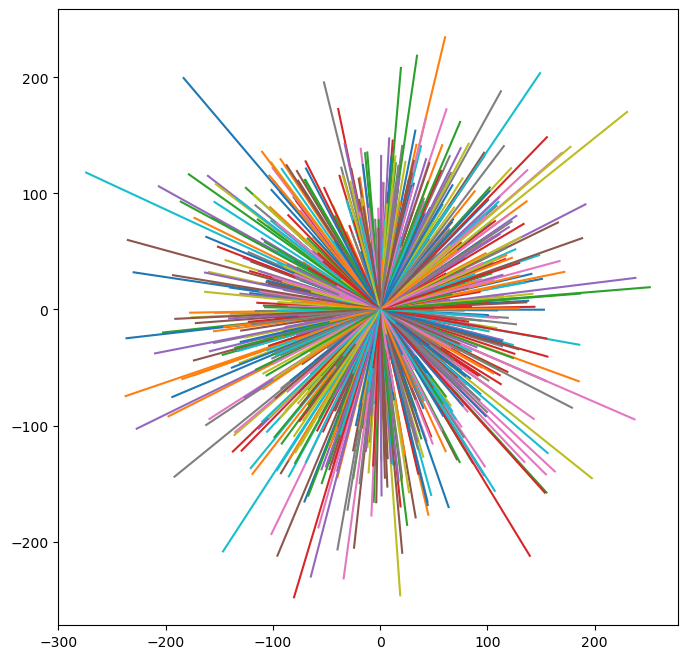

In [16]:
x_traj_np = x_traj.cpu().numpy()
t_steps_np = t_steps.cpu().numpy()
plt.figure(figsize=[8, 8])
plt.plot(x_traj_np[:,:,0], x_traj_np[:,:,1], ) # , c=t_steps_np cmap="viridis"
plt.show()